## Doc2Vec

#### Train

In [24]:
import pandas as pd
import numpy as np
import glob
import re
import string
from bs4 import BeautifulSoup

# sklearn
from sklearn.feature_extraction.text import CountVectorizer,TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report, precision_score, recall_score, f1_score

# nltk
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords 

# visualization 
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

[nltk_data] Downloading package stopwords to C:\Users\Hana
[nltk_data]     Baron\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to C:\Users\Hana
[nltk_data]     Baron\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [25]:
df = pd.read_csv('datasets\processed_data_V2.csv')

In [26]:
df.head()

,Description,JobTitle
0,"['avis', 'budget', 'group', 'actionpacked', 'h...",Automotive Technician
1,"['service', 'technician', 'every', 'employee',...",Automotive Technician
2,"['avis', 'budget', 'group', 'actionpacked', 'h...",Automotive Technician
3,"['even', 'opportunities', 'sunnier', 'region’s...",Family Physician
4,"['lincoln', 'heritage', 'life', 'insurance', '...",Insurance Sales Agent


In [55]:
from ast import literal_eval
def join_words(list_of_words):
    list_of_words= literal_eval(list_of_words)
    joined = (' '.join(list_of_words))
#     print(joined)
    return joined

In [56]:
df['Description_join'] = df.Description.apply(join_words)

In [58]:
from gensim.models.doc2vec import Doc2Vec , TaggedDocument
corpus = [TaggedDocument(doc.split(' '), [i]) for i, doc in enumerate(df['Description_join'])]

In [59]:
model = Doc2Vec(vector_size=64, min_count=1, epochs = 20)

In [60]:
#instantiate model
model = Doc2Vec(vector_size=64, window=2, min_count=1, workers=8, epochs = 40)
#build vocab
model.build_vocab(corpus)
#train model
model.train(corpus, total_examples=model.corpus_count, epochs=model.epochs)

In [61]:
#generate vectors
dec2vec = [model.infer_vector((df['Description_join'] [i].split(' '))) for i in range(0,len(df['Description_join'] ))]
dec2vec

[array([-0.77039653, -0.72393024,  0.26315373, -0.8072191 , -0.82859707,
        -0.6969269 , -1.5935044 , -1.6132507 ,  0.749781  ,  1.00989   ,
         0.79842454,  1.8675762 ,  0.42587024,  1.1642742 ,  0.66002965,
         0.74155605,  0.46794012,  1.5443478 , -0.28438115, -0.2893553 ,
        -0.12812251,  0.7083799 , -0.7928356 ,  0.86459523, -0.10197318,
         0.10619024,  0.28322858,  1.0200107 , -0.45218527,  1.6563271 ,
         1.4381262 ,  1.7177204 , -0.9162723 ,  0.50186163,  1.1440796 ,
         0.26003206, -0.04348515,  0.6974856 ,  0.11467038, -2.1545918 ,
        -0.6164185 , -0.5431721 , -0.20081419, -0.09223256,  0.53885037,
         0.65373904,  0.10037694,  0.5026235 , -0.9784209 ,  0.9113884 ,
         1.5583929 ,  0.22812603,  0.8519715 ,  0.01164696, -0.16657817,
        -0.6371944 ,  0.71841925,  1.5483456 ,  0.48069525, -0.60847807,
         1.1472665 ,  1.8210334 ,  0.7327029 , -1.0418798 ], dtype=float32),
 array([ 1.124414  , -0.08338337,  1.2619345 , 

In [62]:
import numpy as np
#Create a list of lists
dtv= np.array(dec2vec).tolist()
#set list to dataframe column
df['dec2vecc'] = dtv
df.head(2)

,Description,JobTitle,Description_join,dec2vecc
0,"['avis', 'budget', 'group', 'actionpacked', 'h...",Automotive Technician,avis budget group actionpacked highenergy work...,"[-0.7703965306282043, -0.7239302396774292, 0.2..."
1,"['service', 'technician', 'every', 'employee',...",Automotive Technician,service technician every employee starling che...,"[1.1244139671325684, -0.08338336646556854, 1.2..."


In [63]:
# df.to_csv('datasets\processed_data_doc2vec.csv', index=False)  

In [64]:
df.head(2)

,Description,JobTitle,Description_join,dec2vecc
0,"['avis', 'budget', 'group', 'actionpacked', 'h...",Automotive Technician,avis budget group actionpacked highenergy work...,"[-0.7703965306282043, -0.7239302396774292, 0.2..."
1,"['service', 'technician', 'every', 'employee',...",Automotive Technician,service technician every employee starling che...,"[1.1244139671325684, -0.08338336646556854, 1.2..."


In [65]:
#pip install texthero
import texthero as hero

✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')


In [67]:
df['tsnec2v'] = hero.tsne(df['dec2vecc'])

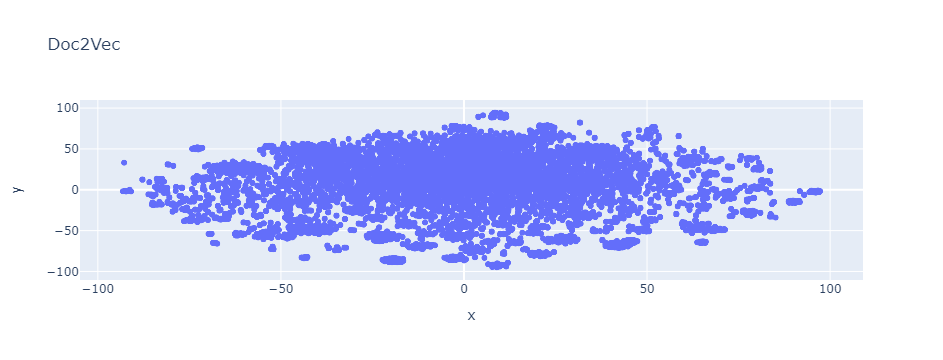

In [70]:
#create scatter plot of doc2vec
hero.scatterplot(df, col='tsnec2v', title="Doc2Vec", hover_data = ['JobTitle','Description_join']) #, color='convertedManaCost'